In [20]:
from scipy.stats import entropy
import pandas
import numpy
from tqdm import tqdm
import sys
import seaborn
import matplotlib
pandas.set_option('display.max_columns', None)
from tqdm.notebook import trange, tqdm
from time import sleep
import numpy
from joblib import Parallel, delayed
seaborn.set_palette("Paired")
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [21]:
import subprocess
import os.path

In [22]:
global OUTPUT_IMAGE_PATH
OUTPUT_IMAGE_PATH = "./../report/fragments/04_experimental_execution/images/"

In [23]:
def instanciate_runner(executable_path, input_path="./", output_path="/tmp"):

    if os.path.exists(executable_path):
        def execute_experiment( input_file:str, input_size:int, extractions:int, output_file:str = None, generate_dataframe=False, enable_reuse=0,
                                log_pivot_time = 0, log_iteration_time = 0, log_extraction_time = 0, log_swaps = 0, use_random_pivot = 0,
                                use_bfprt = 0, use_iiqs = 0, set_bfprt_alpha = 0.3, set_bfprt_beta = 0.7, set_random_seed = 42, 
                                set_pivot_bias = 0.5, set_redundant_bias = 0.5, thread_id="" ):
            if output_file == None:
                output_file = input_file.split("/")[-1]
            arguments = [
            ('--log-iteration-time=' + str(log_iteration_time)),
            ('--log-pivot-time=' + str(log_iteration_time)),
            ('--log-swaps=' + str(log_iteration_time)),
            ('--log-extraction-time=' + str(log_extraction_time)),
            ('--enable-reuse=' + str(enable_reuse)),
            ('--use-bfprt=' + str(use_bfprt)),
            ('--use-iiqs=' + str(use_iiqs)),
            ('--set-bfprt-alpha=' + str(np.round(set_bfprt_alpha,6))),
            ('--set-bfprt-beta=' + str(np.round(set_bfprt_beta,6))),
            ('--use-random-pivot=' + str(use_random_pivot)),
            ('--set-random-seed=' + str(set_random_seed)),
            ('--set-pivot-bias=' + str(np.round(set_pivot_bias,6))),
            ('--set-redundant-bias=' + str(np.round(set_redundant_bias, 6))),
            ('--input-file=' + '/'.join([input_path, str(input_file)])),
            ('--output-file=' + '/'.join([output_path, str(output_file + thread_id)])),
            ('--input-size=' + str(input_size)),
            ('--extractions=' + str(extractions))]
            # print(" ".join([''+executable_path] + arguments))
            result = subprocess.run(" ".join([''+executable_path] + arguments), shell=True,  stdout=subprocess.PIPE, stderr=subprocess.PIPE)
            # print(result.stdout.decode('utf-8'))
            # print(result.stderr.decode('utf-8'))
            result_df = pandas.read_csv('/'.join([output_path, str(output_file + thread_id)]))
            
            result_deletion = subprocess.run(
                ("rm " + '/'.join([output_path, str(output_file + thread_id)]))
                , shell=True,  stdout=subprocess.PIPE, stderr=subprocess.PIPE)
            
            return result_df
        return execute_experiment
    else:
        return None

In [24]:
#runner = instanciate_runner('/home/kuky_nekoi/magicode/program/base_benchmark/main')
runner = instanciate_runner('/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/program/base_benchmark/main_prototype',
                            input_path='/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/01_base_benchmark_data')

In [11]:
from mpl_toolkits import mplot3d
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

def log_column(column):
    def _lambda(df):
        df["log("+column+")"] = numpy.log10(df[column])
        return df
    return _lambda

In [25]:
redundant_bias = 0.5
pivot_bias = 0.0

def parallel_iiqs(alpha, beta, filename, extractions=10, postprocess=None, redundant_bias_param = redundant_bias, pivot_bias_param = pivot_bias):
    alpha = np.round(alpha,7)
    beta = np.round(beta,7)
    print("parallel_iiqs(alpha={}, beta={}, filename={}, extractions={})".format(alpha, beta, filename, extractions))
    result_iiqs = runner(filename, n, extractions, 
                        generate_dataframe=True,
                        log_extraction_time=1,
                        set_pivot_bias=pivot_bias_param, use_iiqs=1, 
                        use_bfprt=1, set_redundant_bias=redundant_bias_param,
                        set_bfprt_alpha=alpha, set_bfprt_beta=beta, 
                        thread_id= "_iiqs_"+str(alpha)+"_"+str(beta))
    result_iiqs["experiment.classes"] = 0
    result_iiqs["experiment.noise"] = n
    if postprocess:
        result_iiqs = postprocess(result_iiqs)
    return result_iiqs

def parallel_iqs(alpha, beta, filename, extractions=10, postprocess=None, redundant_bias_param = redundant_bias, pivot_bias_param = pivot_bias):
    alpha = np.round(alpha,7)
    beta = np.round(beta,7)
    print("parallel_iqs(alpha={}, beta={}, filename={}, extractions={})".format(alpha, beta, filename, extractions))
    result_iqs = runner(filename, n, extractions, 
                    generate_dataframe=True,
                    log_extraction_time=1,
                    set_pivot_bias=pivot_bias_param, use_iiqs=0, set_redundant_bias=redundant_bias_param,
                    set_bfprt_alpha=alpha, set_bfprt_beta=beta, 
                    thread_id= "_iqs_"+str(alpha)+"_"+str(beta))
    result_iqs["experiment.classes"] = 0
    result_iqs["experiment.noise"] = n
    if postprocess:
        result_iiqs = postprocess(result_iiqs)
    return result_iqs

In [26]:
import plotting
#"bins/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"
N = 5
n = 10**N
extractions=10
pivot_bias = 0.0
redundant_bias = 0.5
## Iterate for all classes available with 10% increments
increment_10p = int(n/100)
fold = 1
alpha_values = list(numpy.arange(0,1,0.01))
beta_values = list(numpy.arange(0,1,0.01))
combinations = []
for alpha in alpha_values:
    for beta in beta_values:
        if(alpha <= beta):
            combinations.append((alpha, beta,))
R = 0

In [27]:
plotting.set_output_image_path(OUTPUT_IMAGE_PATH)

In [8]:
filename = 'random/N_6.fold_1.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, extractions=extractions, algorithm=1, n=n, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

dataframes = []
dataframes.extend(iiqs_results)
        
result_df_alphabeta = plotting.log_column('snapshot.extraction_time')(pandas.concat(dataframes))
result_df_alphabeta = result_df_alphabeta.sort_values(["snapshot.extraction_time"])
result_df_alphabeta["param.alpha_value"] = result_df_alphabeta["alpha_value"]

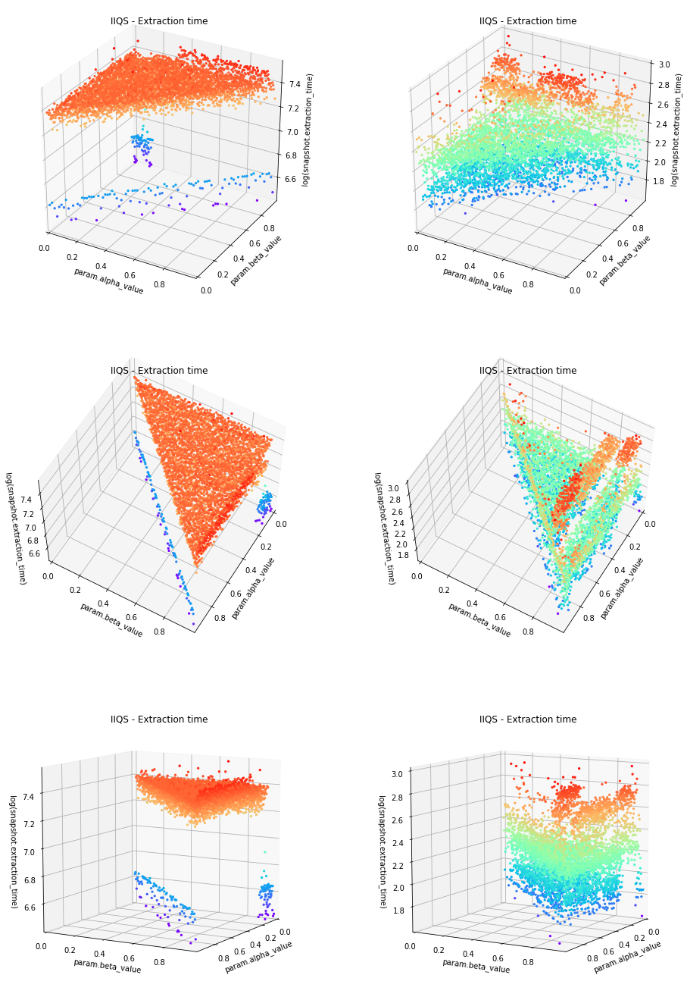

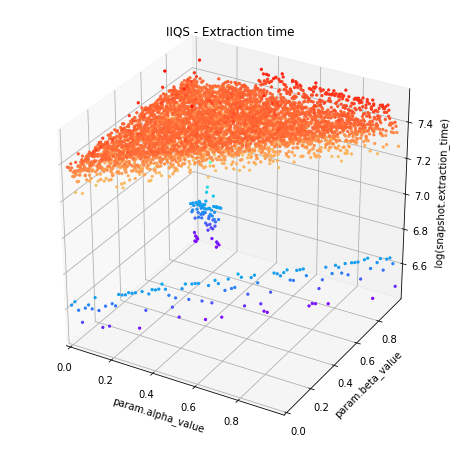

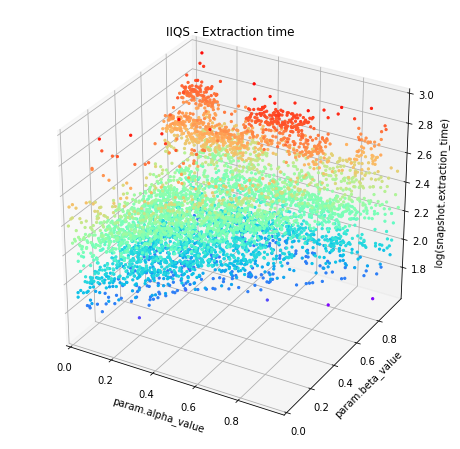

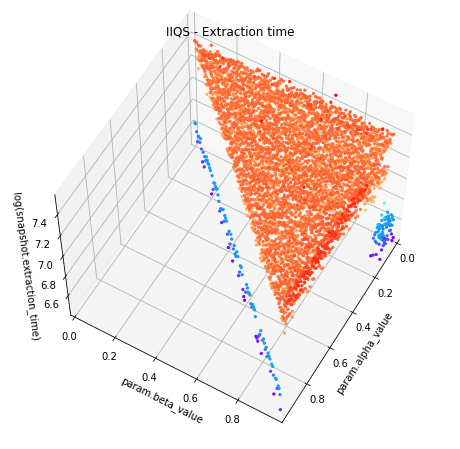

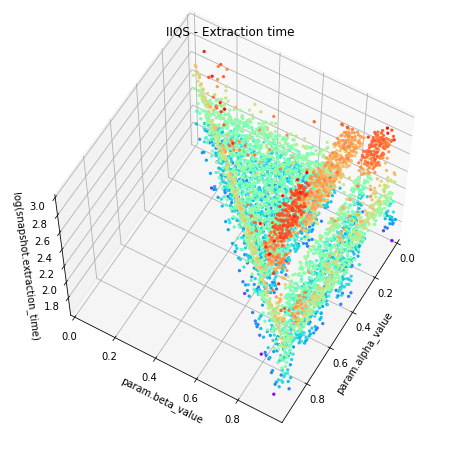

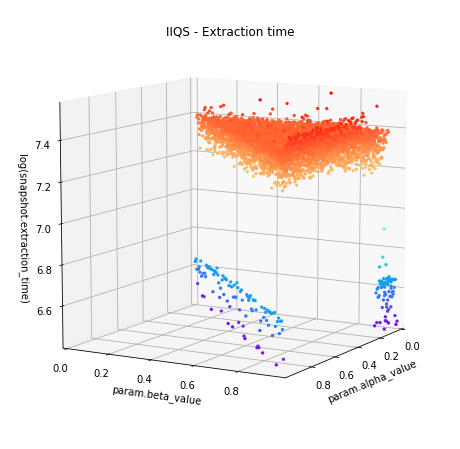

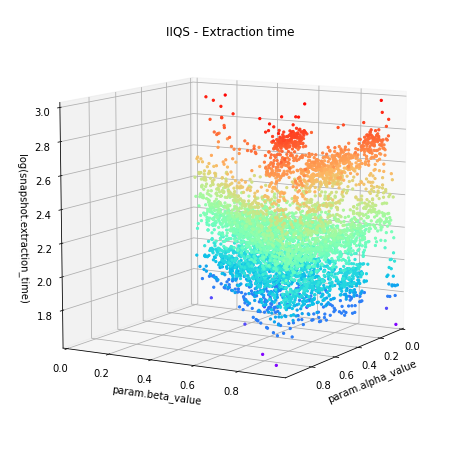

In [11]:
plotting.plot_base_benchmark_3d(x='param.alpha_value',y='param.beta_value',z='log(snapshot.extraction_time)',
                       algorithm_1=1, algorithm_2=1, 
                       algorithm_name_1="IQS", algorithm_name_2="IIQS",
                       default_filters_1=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 0)],
                       default_filters_2=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 1)],
                       data=result_df_alphabeta, filters=[], 
                       title="Extraction time", file="04_alphabeta_noclass.png", s=5)

In [12]:
filename = 'sorted_increasing/N_6.ascii'


iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

dataframes = []
dataframes.extend(iiqs_results)
        

result_df_alphabeta_asc = plotting.log_column('snapshot.extraction_time')(pandas.concat(dataframes))
result_df_alphabeta_asc = result_df_alphabeta_asc.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_asc["param.alpha_value"] = result_df_alphabeta_asc["alpha_value"]

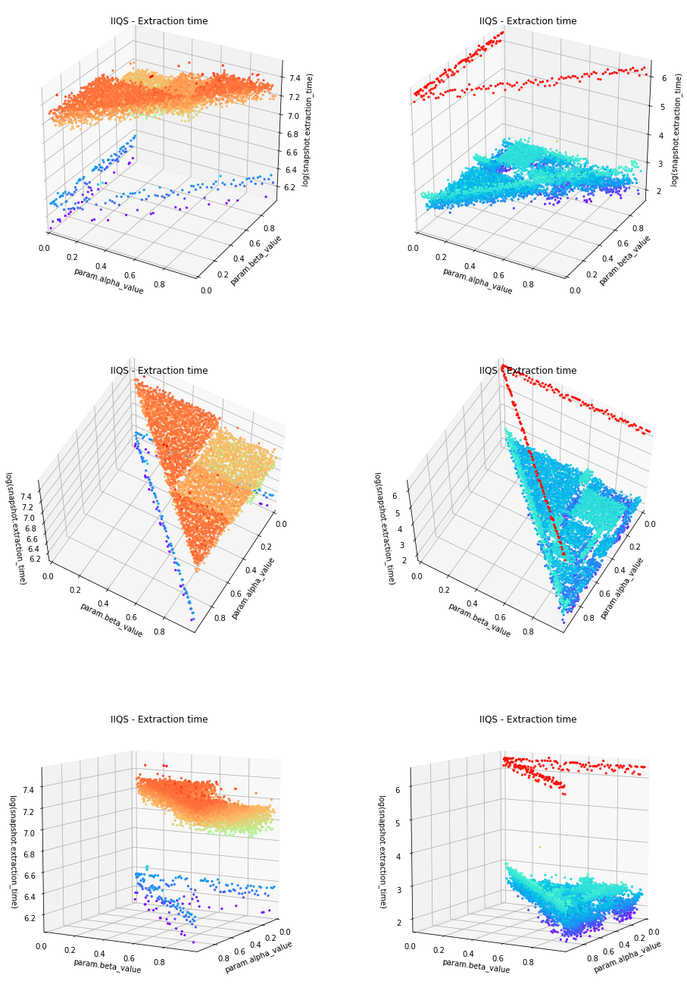

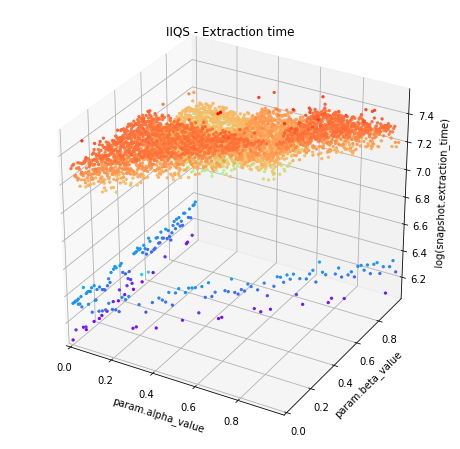

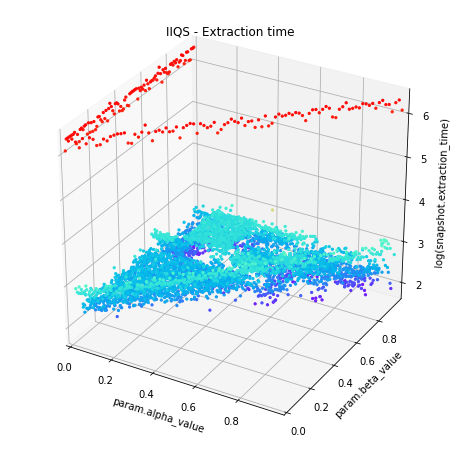

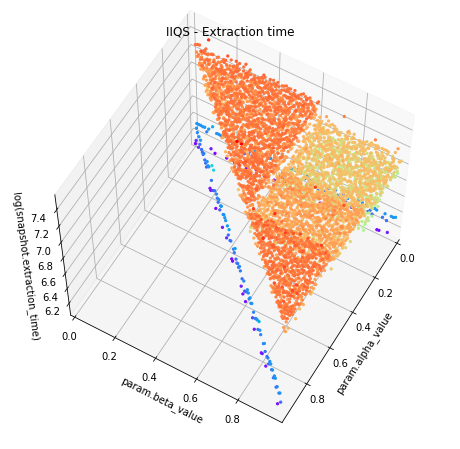

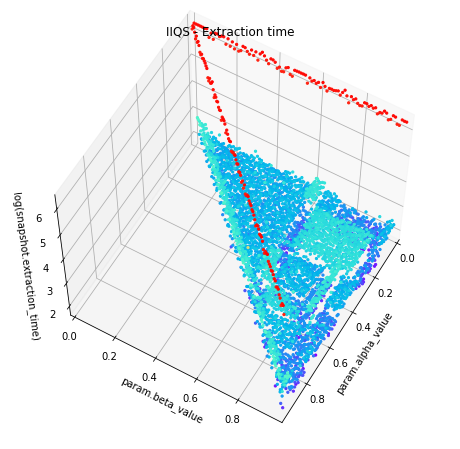

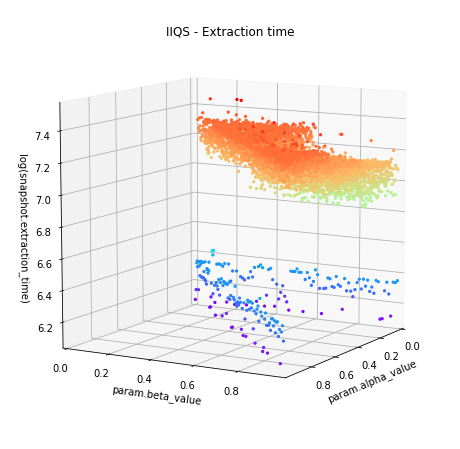

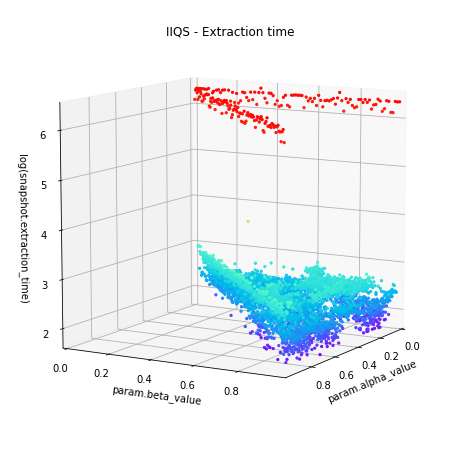

In [13]:
plotting.plot_base_benchmark_3d(x='param.alpha_value',y='param.beta_value',z='log(snapshot.extraction_time)',
                       algorithm_1=1, algorithm_2=1, 
                       algorithm_name_1="IIQS", algorithm_name_2="IIQS",
                       default_filters_1=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 0)],
                       default_filters_2=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 1)],
                       data=result_df_alphabeta_asc, filters=[], 
                       title="Extraction time", file="04_alphabeta_noclass_asc.png", s=5)

In [14]:
filename = 'sorted_decreasing/N_6.ascii'

iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

dataframes = []
dataframes.extend(iiqs_results)
        
result_df_alphabeta_desc = log_column('snapshot.extraction_time')(pandas.concat(dataframes))
result_df_alphabeta_desc = result_df_alphabeta_desc.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_desc["param.alpha_value"] = result_df_alphabeta_desc["alpha_value"]

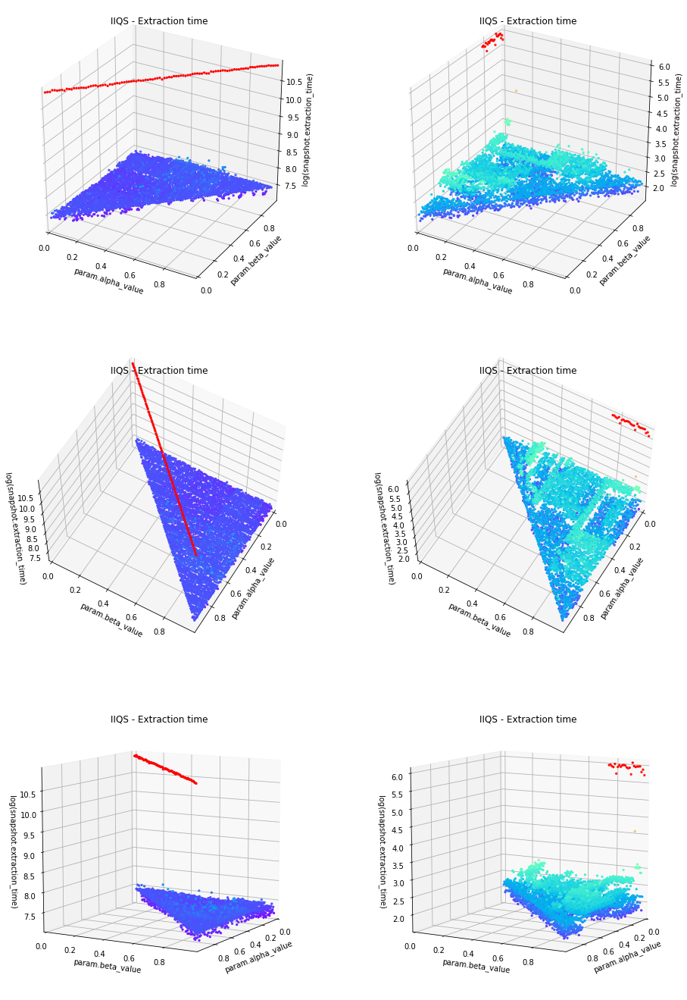

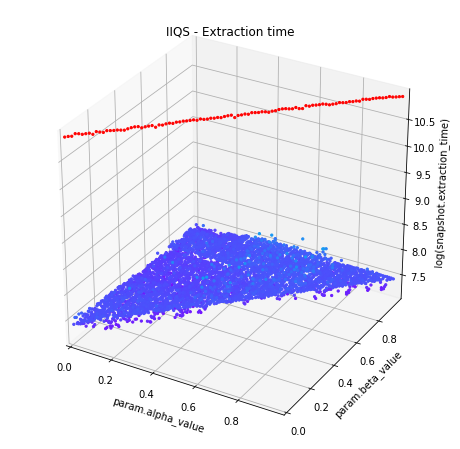

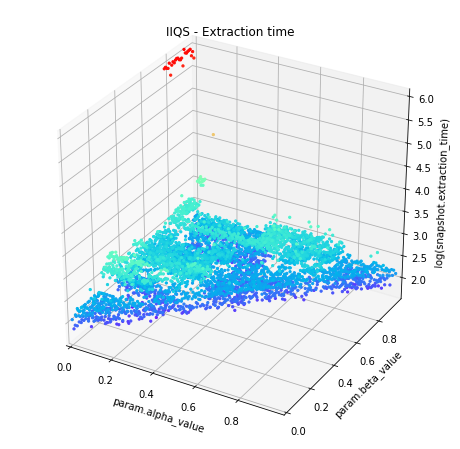

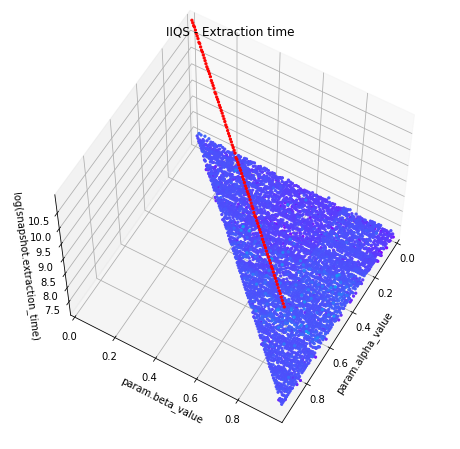

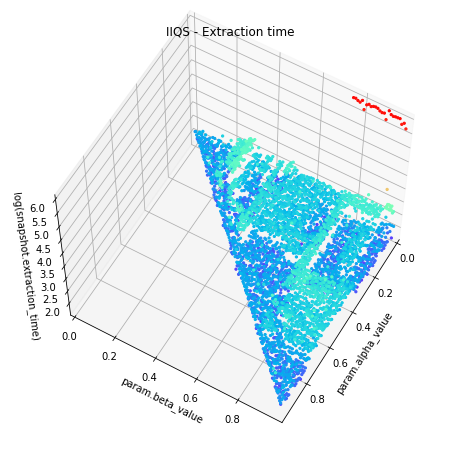

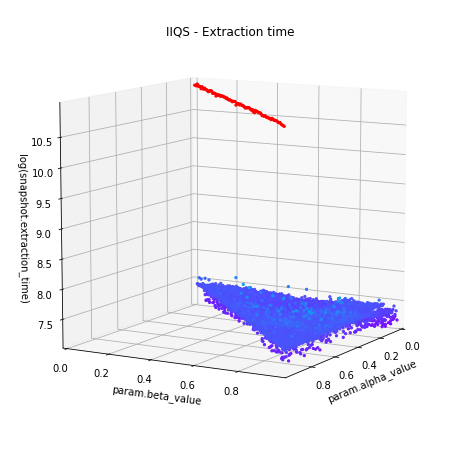

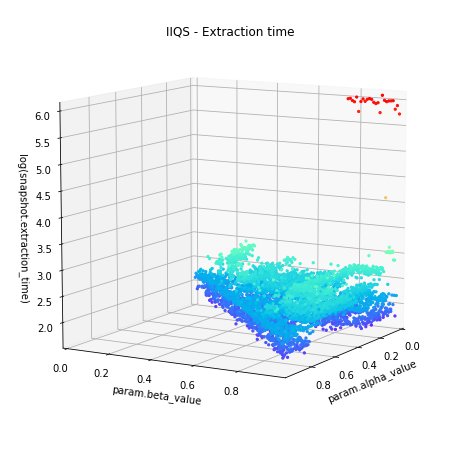

In [15]:
plotting.plot_base_benchmark_3d(x='param.alpha_value',y='param.beta_value',z='log(snapshot.extraction_time)',
                       algorithm_1=1, algorithm_2=1, 
                       algorithm_name_1="IIQS", algorithm_name_2="IIQS",
                       default_filters_1=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 0)],
                       default_filters_2=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 1)],
                       data=result_df_alphabeta_desc, filters=[], 
                       title="Extraction time", file="04_alphabeta_noclass_desc.png", s=5)

In [16]:
import plotting
plotting.set_output_image_path(OUTPUT_IMAGE_PATH)
#"bins/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"
N = 5
n = 10**N
extractions = 10**N
pivot_bias = 0.0
redundant_bias = 0.5
## Iterate for all classes available with 10% increments
increment_10p = int(n/100)
fold = 1
alpha_values = list(numpy.arange(0.0,0.4,0.1))
beta_values = list(numpy.arange(0.7,1.0,0.1))
combinations = []
for alpha in alpha_values:
    for beta in beta_values:
        if(alpha < beta):
            combinations.append((numpy.round(alpha,2), numpy.round(beta,2),))
R = 0
len(combinations)

16

In [17]:
filename = 'random/N_6.fold_1.ascii'

iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_rand_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_rand_d = result_df_alphabeta_rand_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_rand_d["param.alpha_value"] = result_df_alphabeta_rand_d["alpha_value"]

result_df_alphabeta_rand_d["variant"]  = "a" + result_df_alphabeta_rand_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_rand_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_rand_d, "04_alphabeta_detail_random.png", prepend="RANDOM - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


In [18]:
filename = 'sorted_increasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_asc_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_asc_d = result_df_alphabeta_asc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_asc_d["param.alpha_value"] = result_df_alphabeta_asc_d["alpha_value"]

result_df_alphabeta_asc_d["variant"]  = "a" + result_df_alphabeta_asc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_asc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_asc_d, "04_alphabeta_detail_increasing.png", prepend="ASC - ", hue="variant")

In [19]:
filename = 'sorted_decreasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_desc_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_desc_d = result_df_alphabeta_desc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_desc_d["param.alpha_value"] = result_df_alphabeta_desc_d["alpha_value"]

result_df_alphabeta_desc_d["variant"]  = "a" + result_df_alphabeta_desc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_desc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_desc_d, "04_alphabeta_detail_decreasing.png", prepend="DESC - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:97: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = matplotlib.pyplot.subplots(nrows=1, ncols=1, figsize=(8,8))


/home/kuky_nekoi/.anaconda3/envs/magicode/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


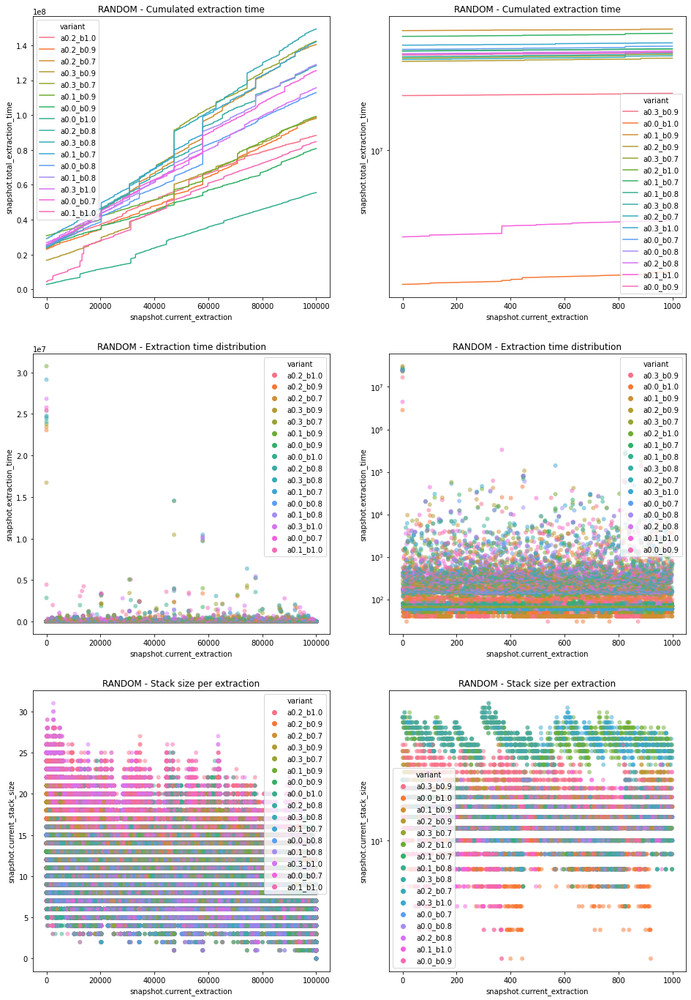

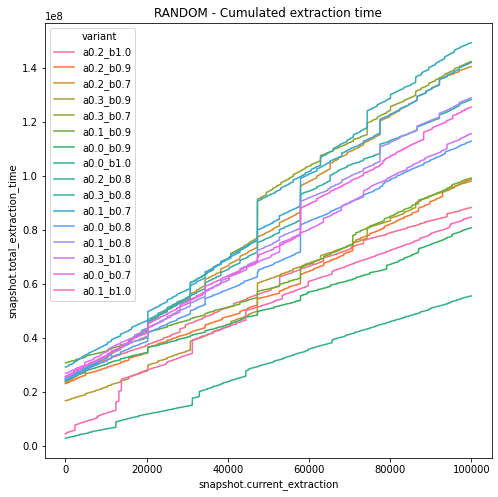

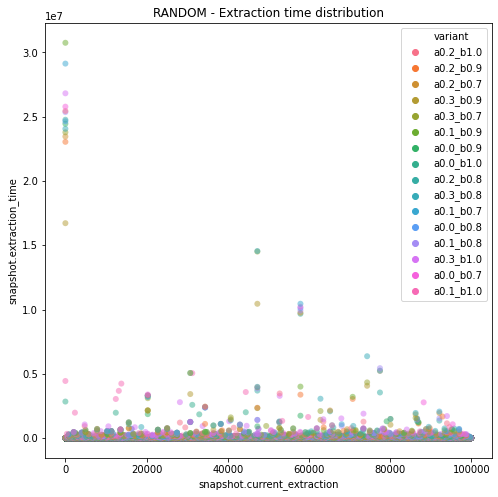

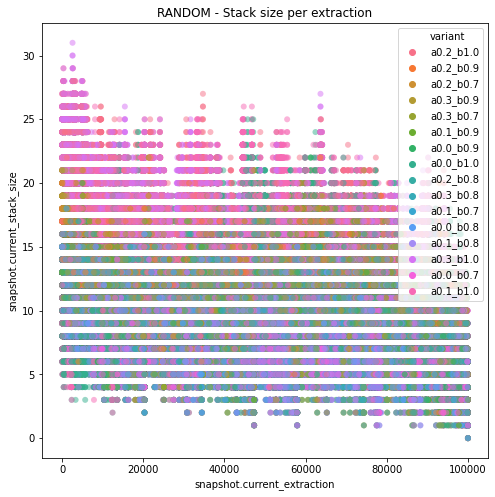

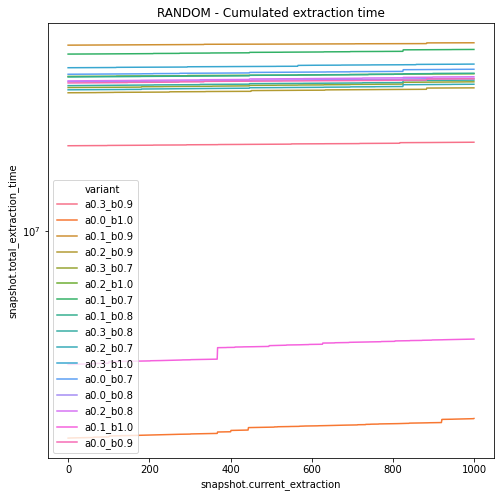

...

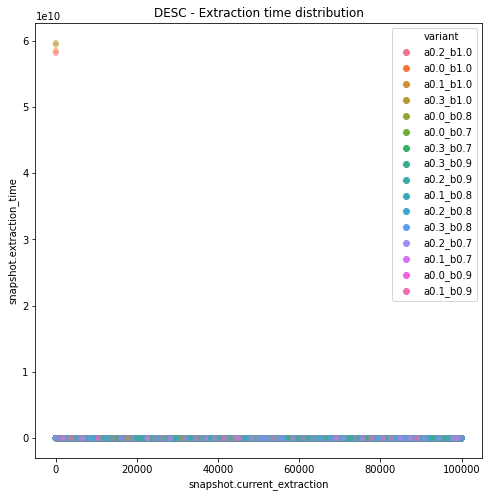

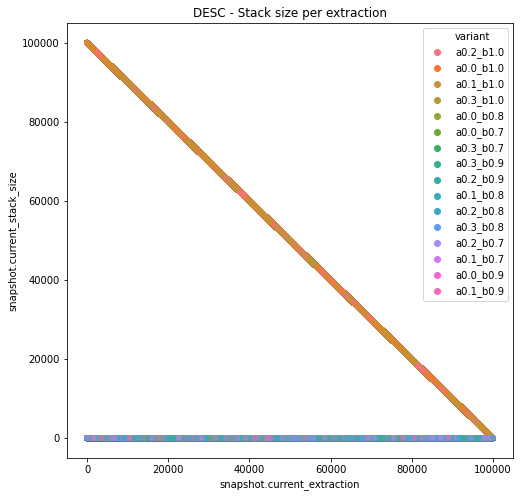

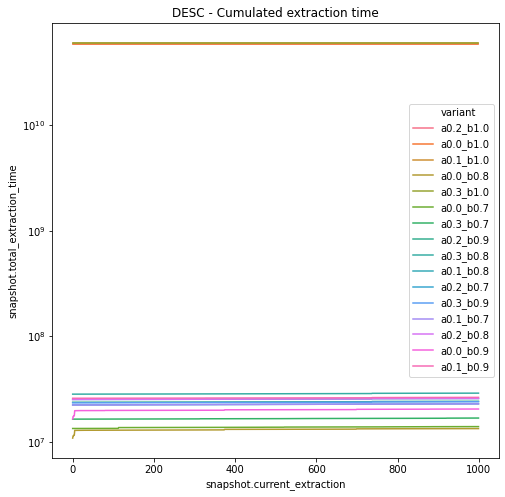

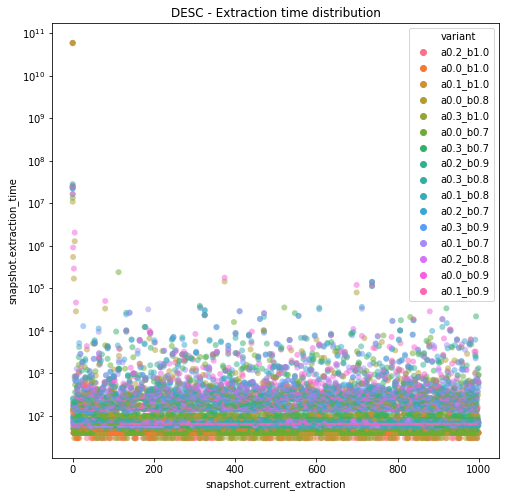

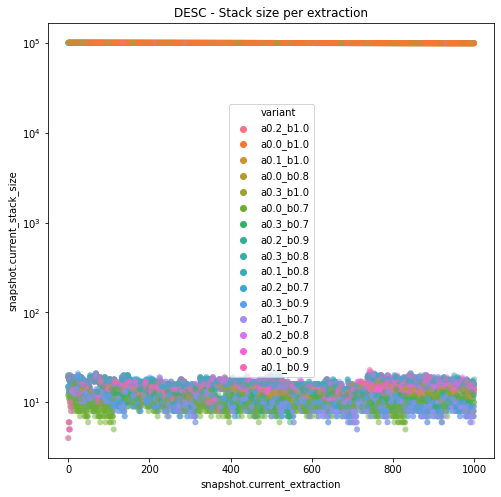

In [20]:
#uwu

In [21]:
#"bins/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"
N = 5
n = 10**N
extractions = 10**N
pivot_bias = 0.0
redundant_bias = 0.5
## Iterate for all classes available with 10% increments
increment_10p = int(n/100)
fold = 1
alpha_values = list(numpy.arange(0.4,0.8,.05))
beta_values = list(numpy.arange(0.4,0.75,.05))
combinations = []
for alpha in alpha_values:
    for beta in beta_values:
        if(alpha < beta):
            combinations.append((numpy.round(alpha,2), numpy.round(beta,2),))
R = 0
display(len(combinations))
combinations


21

[(0.4, 0.45),
 (0.4, 0.5),
 (0.4, 0.55),
 (0.4, 0.6),
 (0.4, 0.65),
 (0.4, 0.7),
 (0.45, 0.5),
 (0.45, 0.55),
 (0.45, 0.6),
 (0.45, 0.65),
 (0.45, 0.7),
 (0.5, 0.55),
 (0.5, 0.6),
 (0.5, 0.65),
 (0.5, 0.7),
 (0.55, 0.6),
 (0.55, 0.65),
 (0.55, 0.7),
 (0.6, 0.65),
 (0.6, 0.7),
 (0.65, 0.7)]

In [22]:
filename = 'random/N_6.fold_1.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_rand_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_rand_d = result_df_alphabeta_rand_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_rand_d["param.alpha_value"] = result_df_alphabeta_rand_d["alpha_value"]

result_df_alphabeta_rand_d["variant"]  = "a" + result_df_alphabeta_rand_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_rand_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_rand_d, "04_alphabeta_detail_random_inner.png", prepend="RANDOM - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


In [23]:
filename = 'sorted_increasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_asc_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_asc_d = result_df_alphabeta_asc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_asc_d["param.alpha_value"] = result_df_alphabeta_asc_d["alpha_value"]

result_df_alphabeta_asc_d["variant"]  = "a" + result_df_alphabeta_asc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_asc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_asc_d, "04_alphabeta_detail_increasing_inner.png", prepend="ASC - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


In [24]:
filename = 'sorted_decreasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_desc_d = log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_desc_d = result_df_alphabeta_desc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_desc_d["param.alpha_value"] = result_df_alphabeta_desc_d["alpha_value"]

result_df_alphabeta_desc_d["variant"]  = "a" + result_df_alphabeta_desc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_desc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_desc_d, "04_alphabeta_detail_decreasing_inner.png", prepend="DESC - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:97: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = matplotlib.pyplot.subplots(nrows=1, ncols=1, figsize=(8,8))
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


20

[(0.0, 0.7),
 (0.02, 0.7),
 (0.03, 0.7),
 (0.04, 0.7),
 (0.06, 0.7),
 (0.08, 0.7),
 (0.09, 0.7),
 (0.1, 0.7),
 (0.12, 0.7),
 (0.14, 0.7),
 (0.15, 0.7),
 (0.16, 0.7),
 (0.18, 0.7),
 (0.2, 0.7),
 (0.21, 0.7),
 (0.22, 0.7),
 (0.24, 0.7),
 (0.26, 0.7),
 (0.27, 0.7),
 (0.28, 0.7)]

/home/kuky_nekoi/.anaconda3/envs/magicode/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


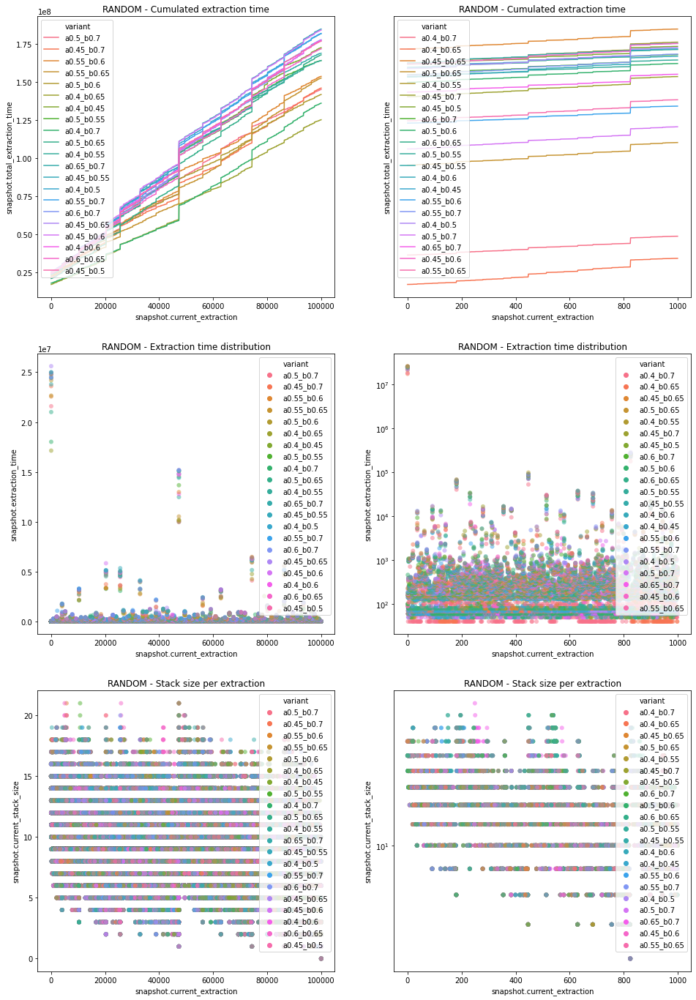

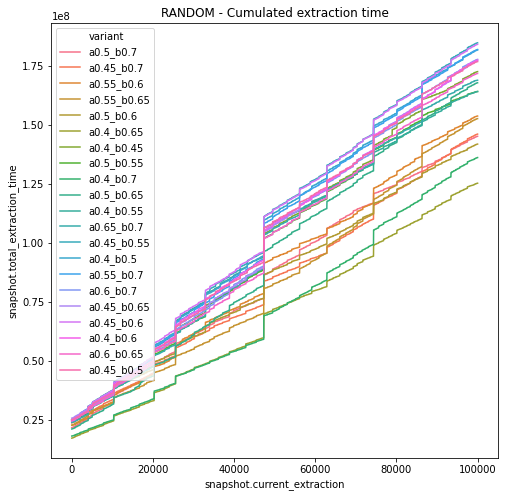

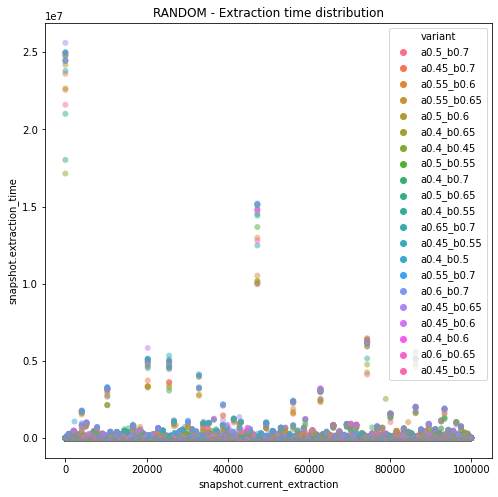

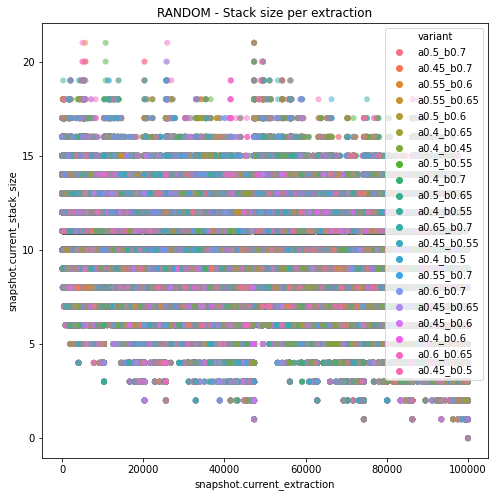

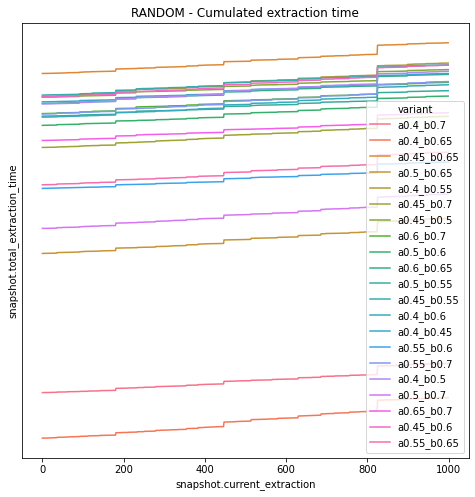

...

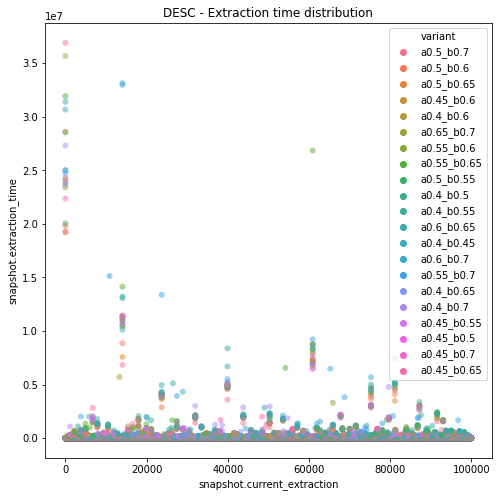

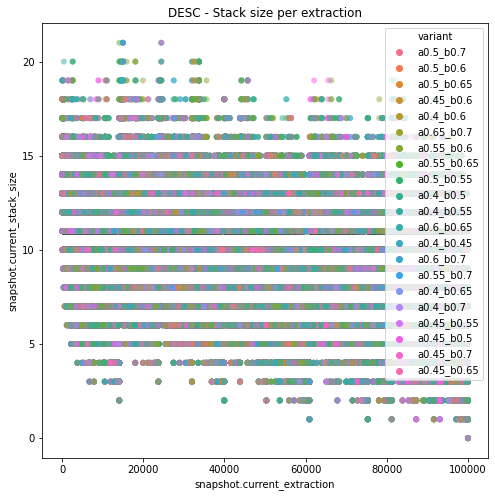

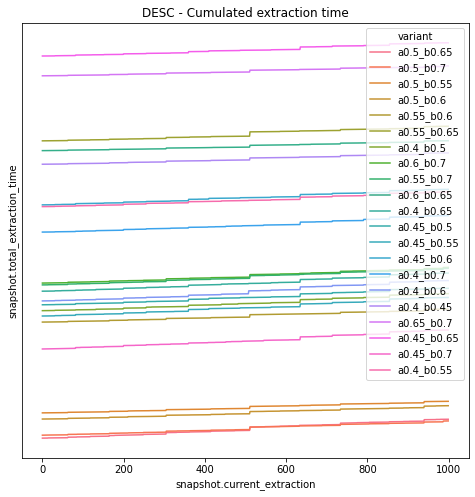

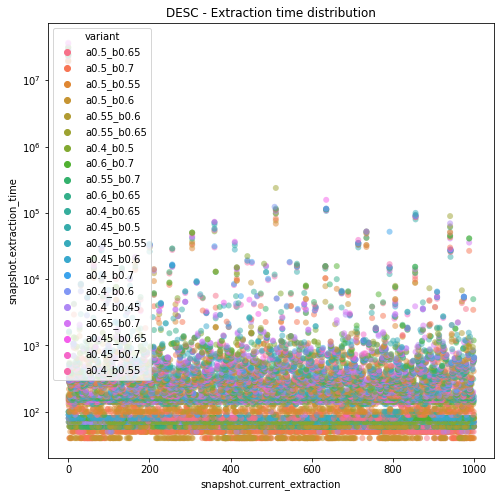

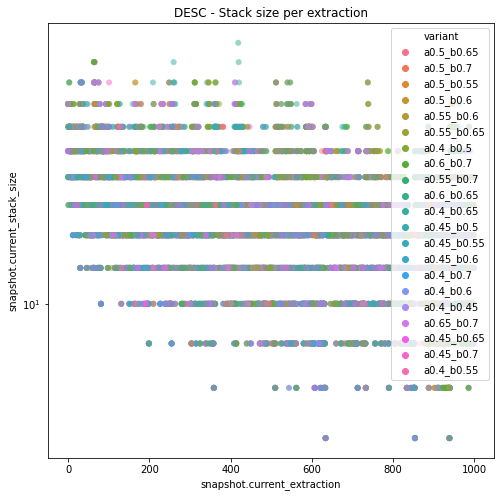

In [25]:
#"bins/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"
N = 5
n = 10**N
extractions = 10**N
pivot_bias = 0.0
redundant_bias = 0.5
## Iterate for all classes available with 10% increments
increment_10p = int(n/100)
fold = 1
alpha_values = list(numpy.arange(0.0,0.3,.015))
beta_values = [0.7]
combinations = []
for alpha in alpha_values:
    for beta in beta_values:
        if(alpha < beta):
            combinations.append((np.round(alpha,2), np.round(beta,2),))
R = 0
display(len(combinations))
combinations


In [26]:
filename = 'random/N_6.fold_1.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )


result_df_alphabeta_rand_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_rand_d = result_df_alphabeta_rand_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_rand_d["param.alpha_value"] = result_df_alphabeta_rand_d["alpha_value"]

result_df_alphabeta_rand_d["variant"]  = "a" + result_df_alphabeta_rand_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_rand_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_rand_d, "04_alphabeta_detail_random_left.png", prepend="RANDOM - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


In [27]:
filename = 'sorted_increasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )


result_df_alphabeta_asc_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_asc_d = result_df_alphabeta_asc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_asc_d["param.alpha_value"] = result_df_alphabeta_asc_d["alpha_value"]

result_df_alphabeta_asc_d["variant"]  = "a" + result_df_alphabeta_asc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_asc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_asc_d, "04_alphabeta_detail_increasing_left.png", prepend="ASC - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


In [28]:
filename = 'sorted_decreasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )


result_df_alphabeta_desc_d = log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_desc_d = result_df_alphabeta_desc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_desc_d["param.alpha_value"] = result_df_alphabeta_desc_d["alpha_value"]

result_df_alphabeta_desc_d["variant"]  = "a" + result_df_alphabeta_desc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_desc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_desc_d, "04_alphabeta_detail_decreasing_left.png", prepend="DESC - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:97: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = matplotlib.pyplot.subplots(nrows=1, ncols=1, figsize=(8,8))
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


21

[(0.3, 0.7),
 (0.3, 0.72),
 (0.3, 0.73),
 (0.3, 0.74),
 (0.3, 0.76),
 (0.3, 0.78),
 (0.3, 0.79),
 (0.3, 0.8),
 (0.3, 0.82),
 (0.3, 0.84),
 (0.3, 0.85),
 (0.3, 0.87),
 (0.3, 0.88),
 (0.3, 0.9),
 (0.3, 0.91),
 (0.3, 0.93),
 (0.3, 0.94),
 (0.3, 0.96),
 (0.3, 0.97),
 (0.3, 0.99),
 (0.3, 1.0)]

/home/kuky_nekoi/.anaconda3/envs/magicode/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


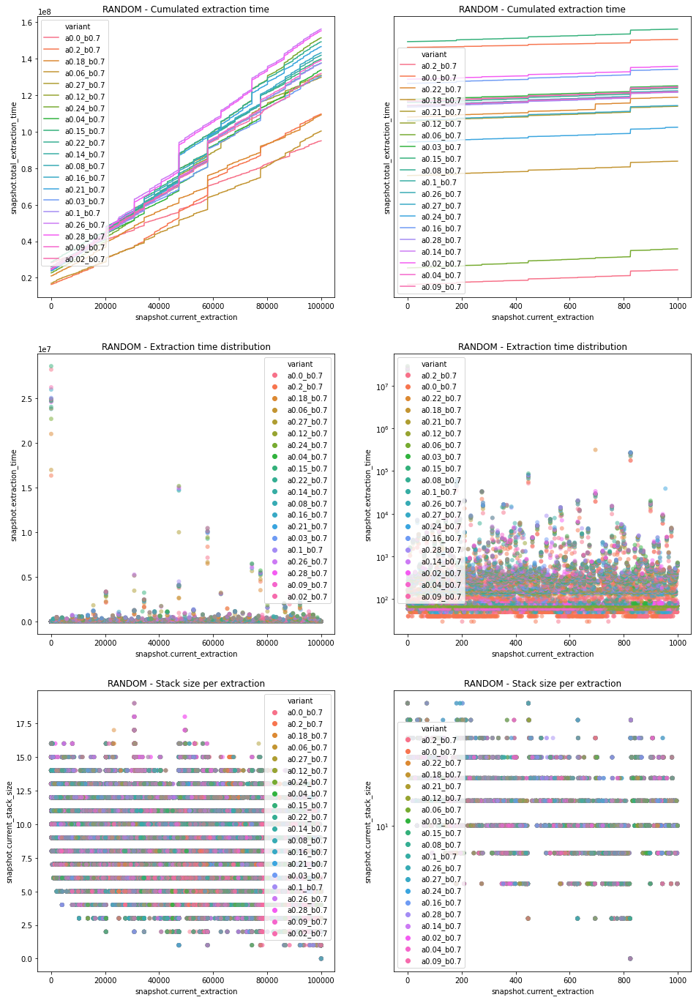

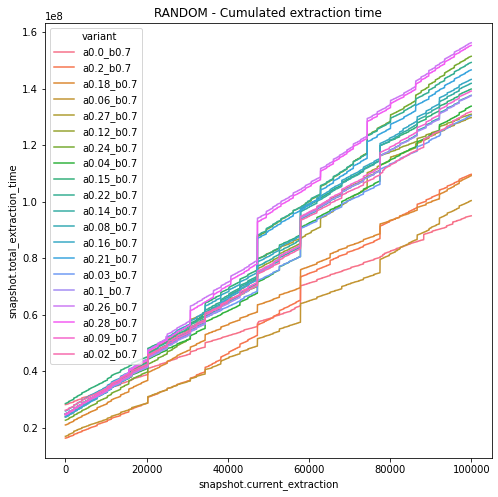

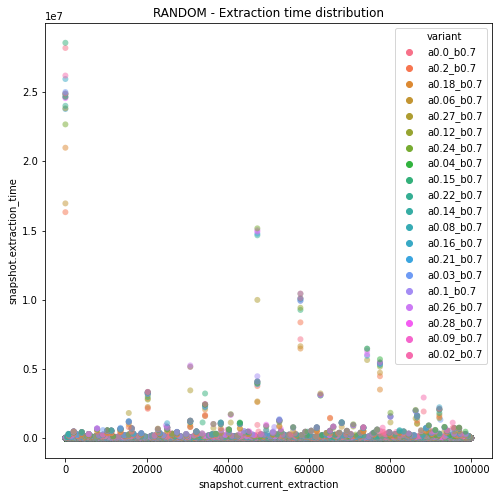

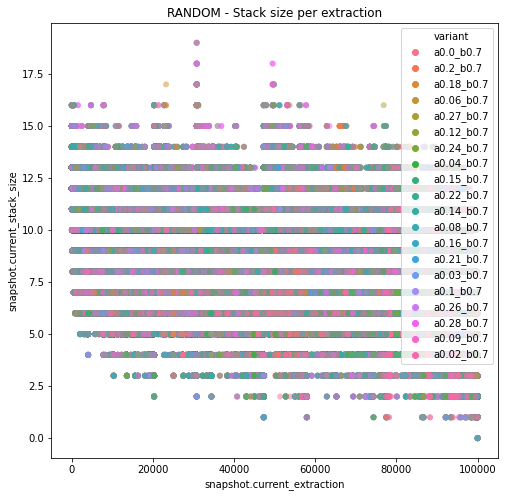

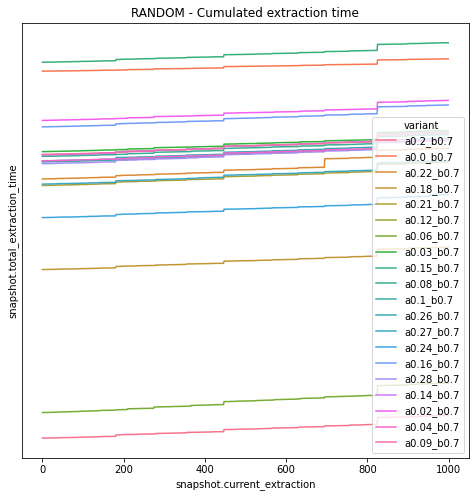

...

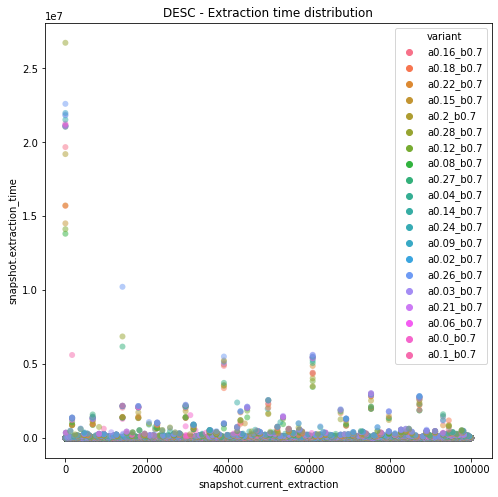

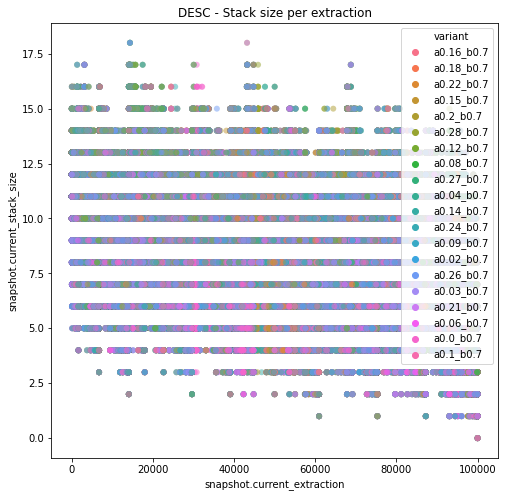

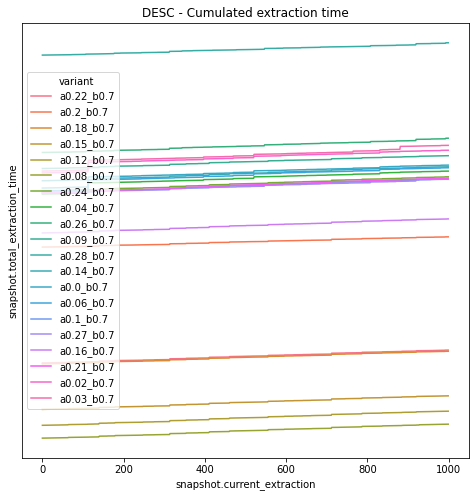

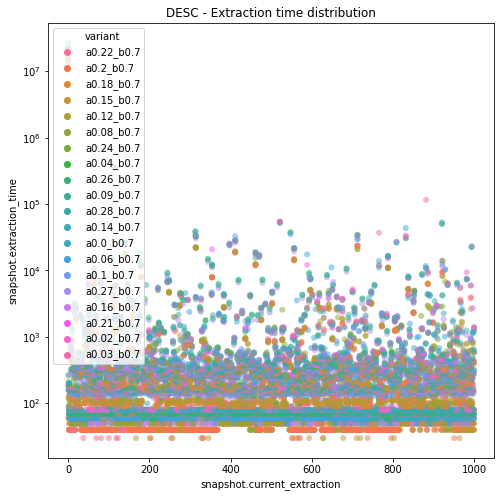

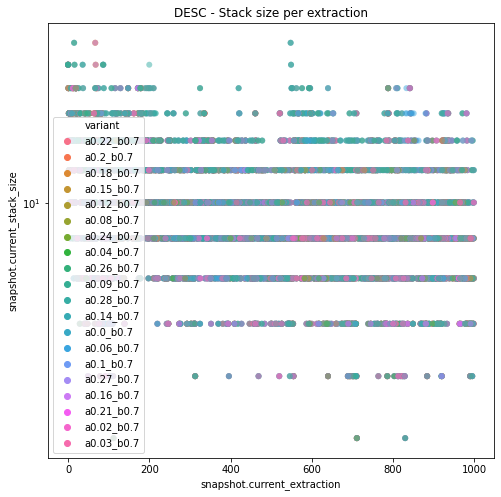

In [29]:
#"bins/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"
N = 5
n = 10**N
extractions = 10**N
pivot_bias = 0.0
redundant_bias = 0.5
## Iterate for all classes available with 10% increments
increment_10p = int(n/100)
fold = 1
alpha_values = [0.3]
beta_values = list(numpy.arange(0.7,1.0,.015))
combinations = []
for alpha in alpha_values:
    for beta in beta_values:
        if(alpha < beta):
            combinations.append((np.round(alpha,2), np.round(beta,2),))
R = 0
display(len(combinations))
combinations


In [30]:
filename = 'random/N_6.fold_1.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_rand_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_rand_d = result_df_alphabeta_rand_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_rand_d["param.alpha_value"] = result_df_alphabeta_rand_d["alpha_value"]

result_df_alphabeta_rand_d["variant"]  = "a" + result_df_alphabeta_rand_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_rand_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_rand_d, "04_alphabeta_detail_random_right.png", prepend="RANDOM - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


In [31]:
filename = 'sorted_increasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_asc_d = plotting.log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_asc_d = result_df_alphabeta_asc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_asc_d["param.alpha_value"] = result_df_alphabeta_asc_d["alpha_value"]

result_df_alphabeta_asc_d["variant"]  = "a" + result_df_alphabeta_asc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_asc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_asc_d, "04_alphabeta_detail_increasing_right.png", prepend="ASC - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


In [32]:
filename = 'sorted_decreasing/N_6.ascii'
iiqs_results = Parallel(n_jobs=10)( delayed(plotting.parallel_riiqs)(filename, algorithm=1, n=n, extractions=extractions, alpha = c[0], beta=c[1], tid="{}_{}".format(c[0], c[1])) for c in combinations )

result_df_alphabeta_desc_d = log_column('snapshot.extraction_time')(pandas.concat(iiqs_results))
result_df_alphabeta_desc_d = result_df_alphabeta_desc_d.sort_values(["snapshot.extraction_time"])
result_df_alphabeta_desc_d["param.alpha_value"] = result_df_alphabeta_desc_d["alpha_value"]

result_df_alphabeta_desc_d["variant"]  = "a" + result_df_alphabeta_desc_d["param.alpha_value"].astype(str) + "_b" + result_df_alphabeta_desc_d["param.beta_value"].astype(str)

plotting.plot_base_benchmark(result_df_alphabeta_desc_d, "04_alphabeta_detail_decreasing_right.png", prepend="DESC - ", hue="variant")

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:105: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(filename + "." + tag + ".png")
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:97: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = matplotlib.pyplot.subplots(nrows=1, ncols=1, figsize=(8,8))
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:144: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.savefig(destination)


/home/kuky_nekoi/.anaconda3/envs/magicode/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


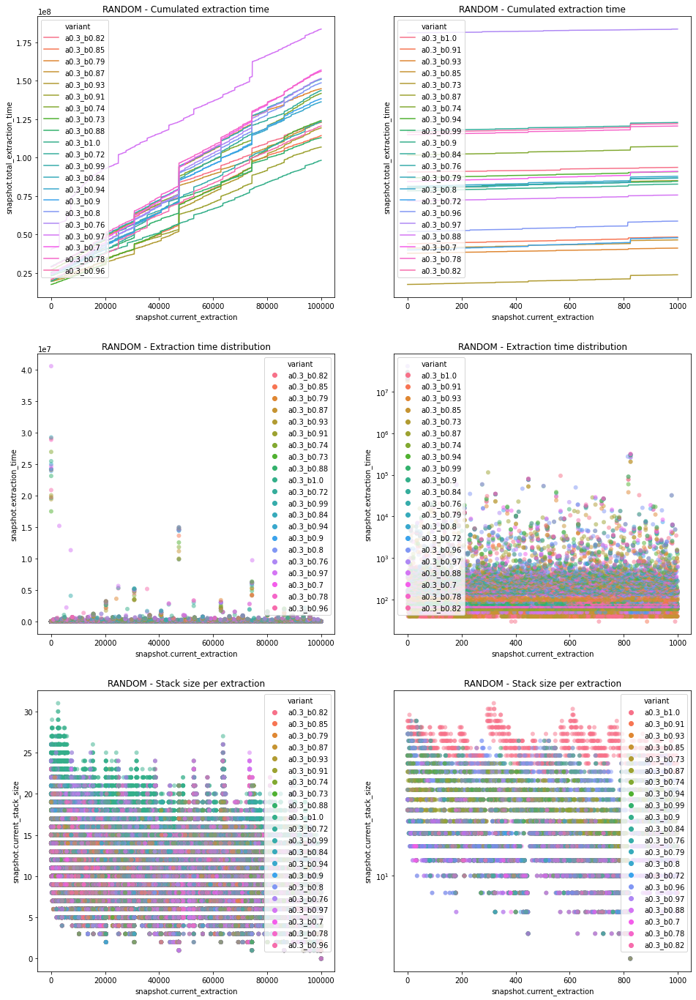

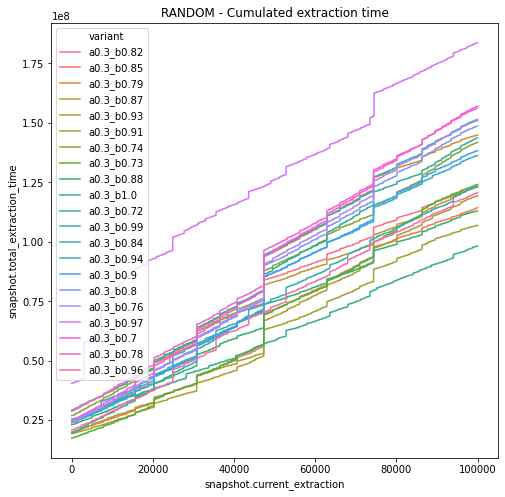

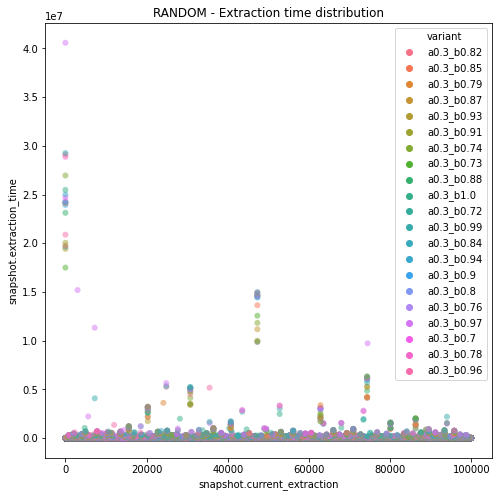

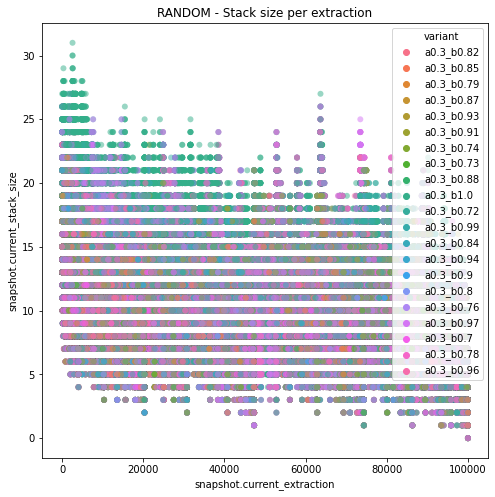

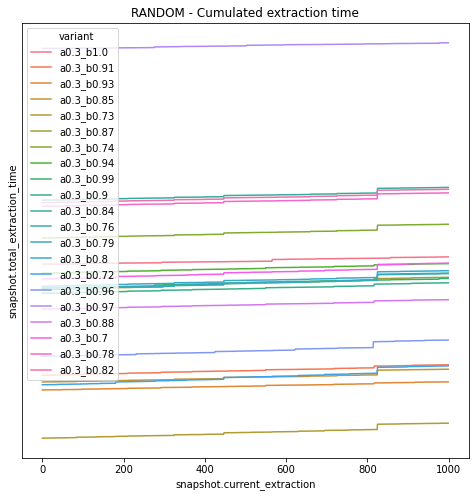

...

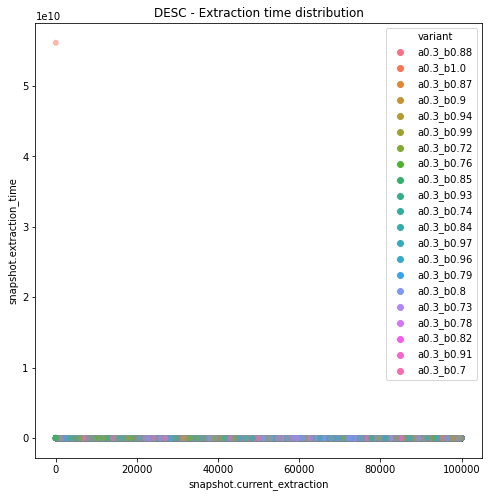

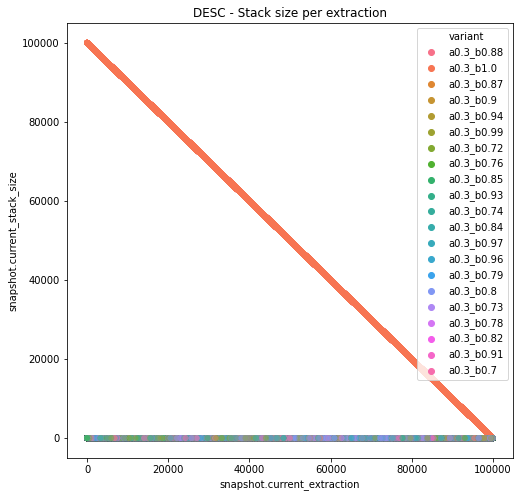

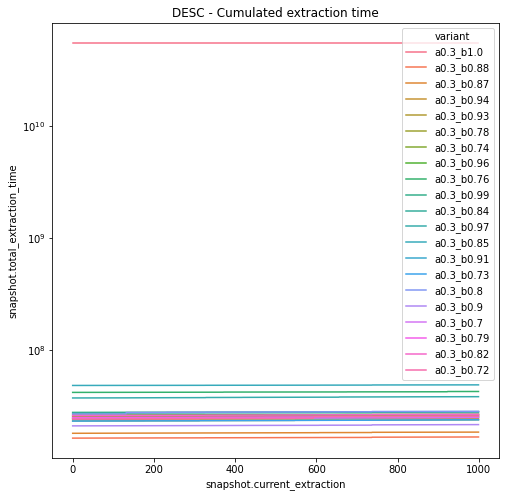

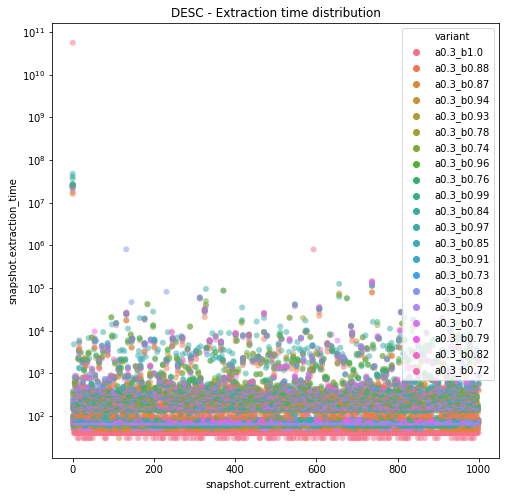

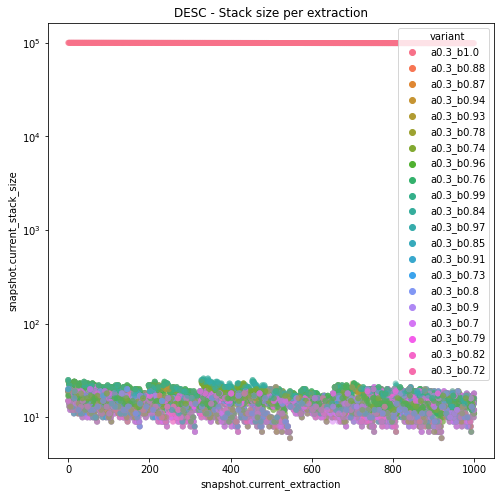

In [33]:
#

In [13]:
def preserve_last(dataframe: pandas.DataFrame, sortby="snapshot.current_extraction") -> pandas.DataFrame:
    #max_index = result_df_alphabeta_rand_d["snapshot.current_extraction"]==max_extract_val
    ## slow as fuck
    #dataframe_ = dataframe.sort_values(["snapshot.current_extraction"])
    #dataframe_last_ = dataframe_.tail(1) 
    dataframe_desc_ = dataframe.describe().to_json()
    idx_ = dataframe["snapshot.current_extraction"].idxmax()
    dataframe_last_ = dataframe.loc[idx_]
    dataframe_last_["experiment.describe"] = dataframe_desc_
    return dataframe_last_.copy(deep=True)

In [28]:
#"bins/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"
N = 4
n = 10**N
extractions=n
pivot_bias = 0.0
redundant_bias = 1
## Iterate for all classes available with 10% increments
increment_10p = int(n/100)
fold = 1
alpha_values = list(numpy.arange(0,1,0.01))
beta_values = list(numpy.arange(0,1,0.01))
combinations = []
for alpha in alpha_values:
    for beta in beta_values:
        if(alpha <= beta):
            combinations.append((alpha, beta,))
R = 0

In [29]:
#filename = 'random/N_6.fold_1.ascii'
C = 1

filename = "one_bin_noise/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"

iiqs_results = Parallel(n_jobs=10)( delayed(parallel_iiqs)(c[0], c[1], 
                                                           filename, 
                                                           extractions=5) for c in combinations )

dataframes = []
dataframes.extend(iiqs_results)
        

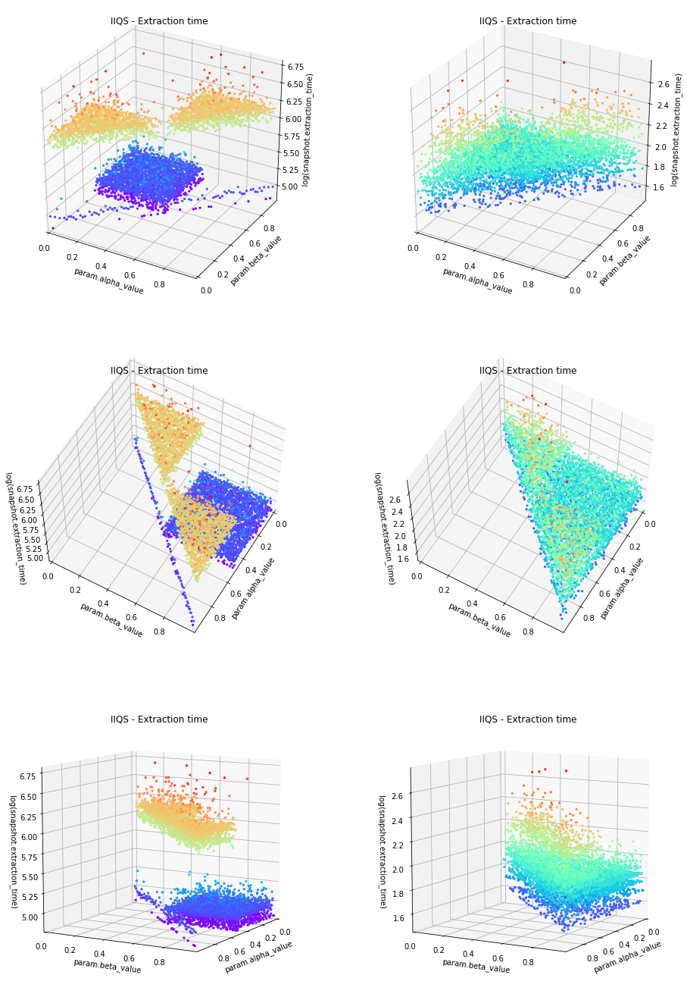

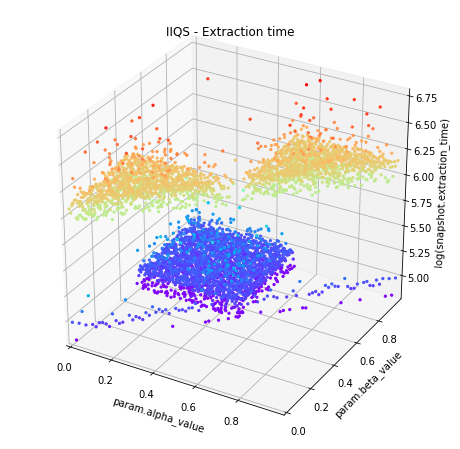

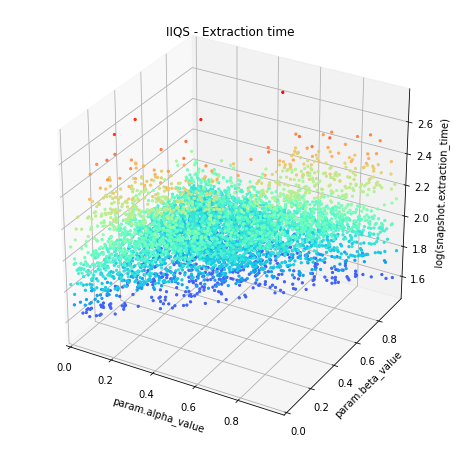

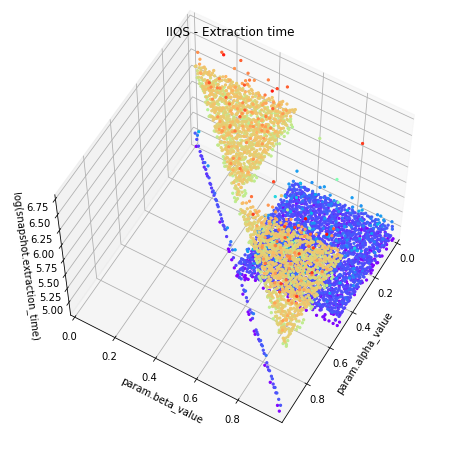

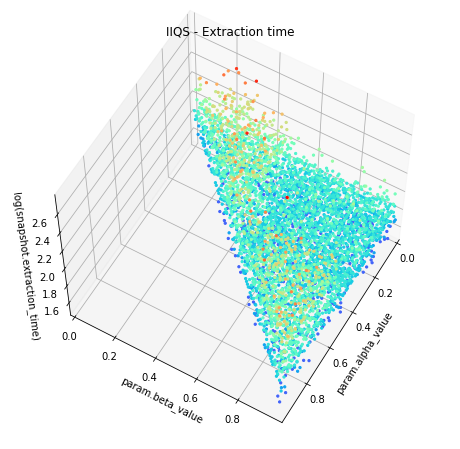

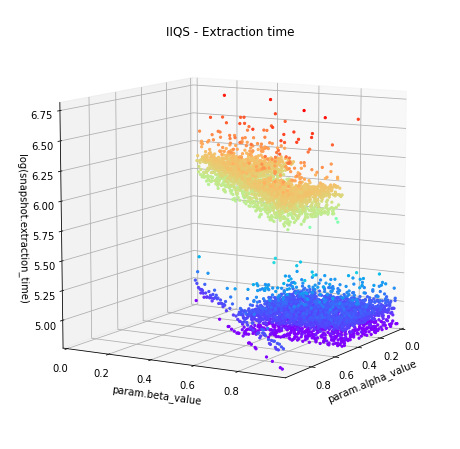

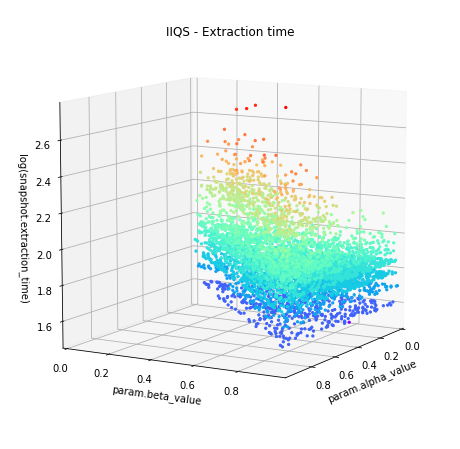

In [30]:
result_df_alphabeta = log_column('snapshot.extraction_time')(pandas.concat(dataframes))
result_df_alphabeta = result_df_alphabeta.sort_values(["snapshot.extraction_time"])
result_df_alphabeta["param.alpha_value"] = result_df_alphabeta["alpha_value"]
plotting.set_output_image_path(OUTPUT_IMAGE_PATH)               
plotting.plot_base_benchmark_3d(x='param.alpha_value',y='param.beta_value',z='log(snapshot.extraction_time)',
                       data=result_df_alphabeta[result_df_alphabeta["snapshot.current_extraction"] < 2], 
                       algorithm_name_1="IIQS", algorithm_name_2="IIQS",
                       default_filters_1=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 0)],
                       default_filters_2=[("param.use_iiqs", "eq", 1), ("snapshot.current_extraction", "eq", 1)],
                       filters=[], 
                       title="Extraction time", file="04_alpabeta_singleclass.png", s=5)

In [31]:
## idk why
#filename = 'random/N_6.fold_1.ascii'
import json

In [33]:
C = 1

filename = "one_bin_noise/N_" + str(N) + "_R_" + str(R) + "_C_" + str(C) + ".fold_" + str(fold) + ".ascii"

iiqs_results = Parallel(n_jobs=10)( delayed(parallel_iiqs)(c[0], c[1], 
                                                           filename, 
                                                           extractions=extractions, 
                                                           postprocess=preserve_last) for c in combinations )

dataframes = []
dataframes.extend(iiqs_results)
        

In [34]:
result_df_alphabeta = pandas.concat(dataframes)
result_df_alphabeta = pandas.DataFrame.from_records(dataframes)
result_df_alphabeta = result_df_alphabeta.sort_values("snapshot.current_stack_size")
result_df_alphabeta["param.alpha_value"] = result_df_alphabeta["alpha_value"]

In [35]:
def append_describe(row) -> pandas.Series:
    x = json.loads(row["experiment.describe"])
    for k_1, v_1 in x.items():
        for k_2, v_2 in v_1.items():
            column = k_1 + ".describe." + k_2
            value = v_2
            row[column] = value
    return row

In [36]:
def parallel_job_apply(dataframe,  apply_function) -> pandas.DataFrame:
    return dataframe.apply(apply_function, axis=1)

def parallel_job_split_apply(dataframe, apply_function, parts=12):
    splitted_dataframe = numpy.array_split(dataframe, parts)
    fragments = Parallel(n_jobs=12)(delayed(parallel_job_apply)(part, apply_function) for part in splitted_dataframe )
    return pandas.concat(fragments)

In [37]:
result_df_alphabeta_proc = parallel_job_split_apply(result_df_alphabeta, append_describe, 12)

In [38]:
[print(x) for x in result_df_alphabeta_proc.columns]

index
param.log_pivot_time
param.log_iteration_time
param.log_extraction_time
param.log_swaps
param.use_bfprt
param.use_iiqs
param.use_dutch_flag
param.use_random_pivot
param.enable_reuse
alpha_value
param.beta_value
param.pivot_bias
param.redundant_bias
random_seed_value
input_size
param.extractions
input_file_value
param.output_file_value
snapshot.iteration_time
snapshot.total_iteration_time
snapshot.partition_time
snapshot.total_partition_time
snapshot.bfprt_partition_time
snapshot.total_bfprt_partition_time
snapshot.extraction_time
snapshot.total_extraction_time
snapshot.current_extraction_executed_partitions
snapshot.total_executed_partitions
snapshot.current_iteration_executed_bfprt_partitions
snapshot.total_executed_bfprt_partitions
snapshot.current_iteration_partition_swaps
snapshot.total_executed_partition_swaps
snapshot.current_iteration_longest_partition_swap
snapshot.total_executed_longest_partition_swap
snapshot.current_iteration_bfprt_partition_swaps
snapshot.total_execut

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,

In [39]:
result_df_alphabeta_proc

,index,param.log_pivot_time,param.log_iteration_time,param.log_extraction_time,param.log_swaps,param.use_bfprt,param.use_iiqs,param.use_dutch_flag,param.use_random_pivot,param.enable_reuse,alpha_value,param.beta_value,param.pivot_bias,param.redundant_bias,random_seed_value,input_size,param.extractions,input_file_value,param.output_file_value,snapshot.iteration_time,snapshot.total_iteration_time,snapshot.partition_time,snapshot.total_partition_time,snapshot.bfprt_partition_time,snapshot.total_bfprt_partition_time,snapshot.extraction_time,snapshot.total_extraction_time,snapshot.current_extraction_executed_partitions,snapshot.total_executed_partitions,snapshot.current_iteration_executed_bfprt_partitions,snapshot.total_executed_bfprt_partitions,snapshot.current_iteration_partition_swaps,snapshot.total_executed_partition_swaps,snapshot.current_iteration_longest_partition_swap,snapshot.total_executed_longest_partition_swap,snapshot.current_iteration_bfprt_partition_swaps,snapshot.total_executed_bfprt_partition_swaps,snapshot.current_iteration_longest_bfprt_partition_swap,snapshot.total_executed_longest_bfprt_partition_swap,snapshot.current_extracted_pivot,snapshot.current_stack_size,snapshot.total_pushed_pivots,snapshot.total_pulled_pivots,snapshot.current_iteration_pushed_pivots,snapshot.current_iteration_pulled_pivots,snapshot.current_extraction,snapshot.input_size,snapshot.snapshot_point,experiment.classes,experiment.noise,experiment.describe,param.alpha_value,index.describe.count,index.describe.mean,index.describe.std,index.describe.min,index.describe.25%,index.describe.50%,index.describe.75%,index.describe.max,param.log_pivot_time.describe.count,param.log_pivot_time.describe.mean,param.log_pivot_time.describe.std,param.log_pivot_time.describe.min,param.log_pivot_time.describe.25%,param.log_pivot_time.describe.50%,param.log_pivot_time.describe.75%,param.log_pivot_time.describe.max,param.log_iteration_time.describe.count,param.log_iteration_time.describe.mean,param.log_iteration_time.describe.std,param.log_iteration_time.describe.min,param.log_iteration_time.describe.25%,param.log_iteration_time.describe.50%,param.log_iteration_time.describe.75%,param.log_iteration_time.describe.max,param.log_extraction_time.describe.count,param.log_extraction_time.describe.mean,param.log_extraction_time.describe.std,param.log_extraction_time.describe.min,param.log_extraction_time.describe.25%,param.log_extraction_time.describe.50%,param.log_extraction_time.describe.75%,param.log_extraction_time.describe.max,param.log_swaps.describe.count,param.log_swaps.describe.mean,param.log_swaps.describe.std,param.log_swaps.describe.min,param.log_swaps.describe.25%,param.log_swaps.describe.50%,param.log_swaps.describe.75%,param.log_swaps.describe.max,param.use_bfprt.describe.count,param.use_bfprt.describe.mean,param.use_bfprt.describe.std,param.use_bfprt.describe.min,param.use_bfprt.describe.25%,param.use_bfprt.describe.50%,param.use_bfprt.describe.75%,param.use_bfprt.describe.max,param.use_iiqs.describe.count,param.use_iiqs.describe.mean,param.use_iiqs.describe.std,param.use_iiqs.describe.min,param.use_iiqs.describe.25%,param.use_iiqs.describe.50%,param.use_iiqs.describe.75%,param.use_iiqs.describe.max,param.use_dutch_flag.describe.count,param.use_dutch_flag.describe.mean,param.use_dutch_flag.describe.std,param.use_dutch_flag.describe.min,param.use_dutch_flag.describe.25%,param.use_dutch_flag.describe.50%,param.use_dutch_flag.describe.75%,param.use_dutch_flag.describe.max,param.use_random_pivot.describe.count,param.use_random_pivot.describe.mean,param.use_random_pivot.describe.std,param.use_random_pivot.describe.min,param.use_random_pivot.describe.25%,param.use_random_pivot.describe.50%,param.use_random_pivot.describe.75%,param.use_random_pivot.describe.max,param.enable_reuse.describe.count,param.enable_reuse.describe.mean,param.enable_reuse.describe.std,param.enable_reuse.describe.min,param.enable_reuse.describe.25%,param.enable_reuse.describe.50%,param.en

/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:223: UserWarning: Attempting to set identical bottom == top == 13.0 results in singular transformations; automatically expanding.
  ax.set_zlim(min(_z), max(_z))
/home/kuky_nekoi/Documents/Sources/KuKy_NeKoi/magicode/experiments/plotting.py:235: UserWarning: Attempting to set identical bottom == top == 13.0 results in singular transformations; automatically expanding.
  ax_.set_zlim(min(_z), max(_z))


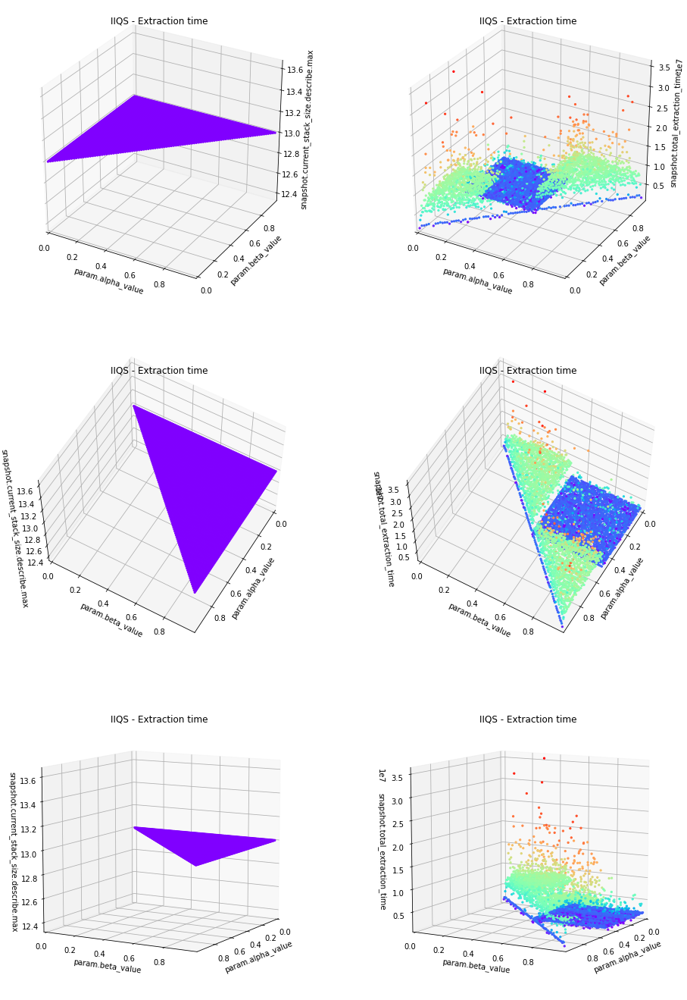

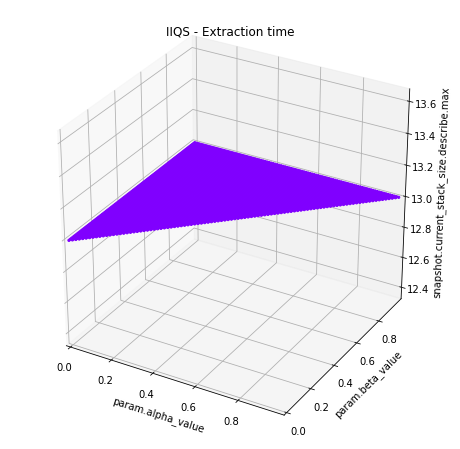

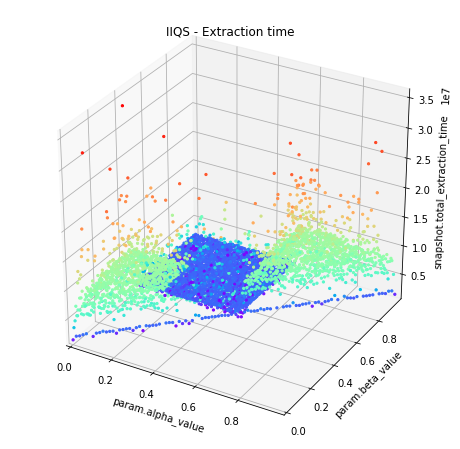

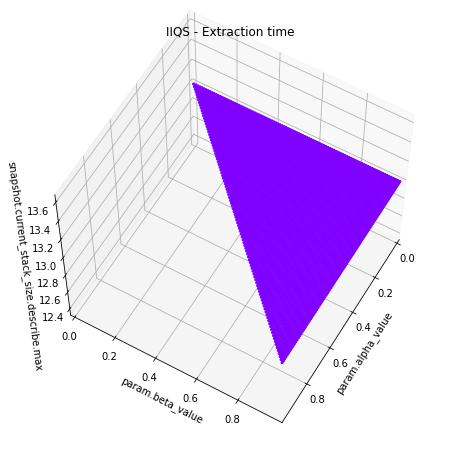

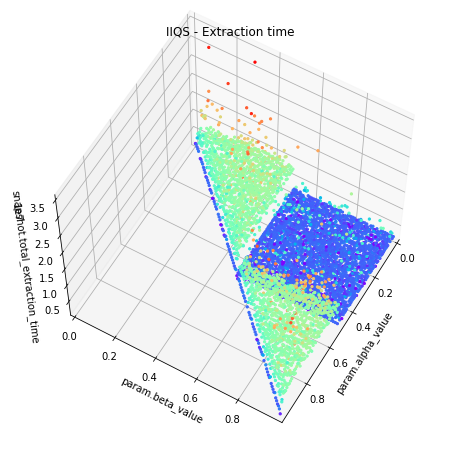

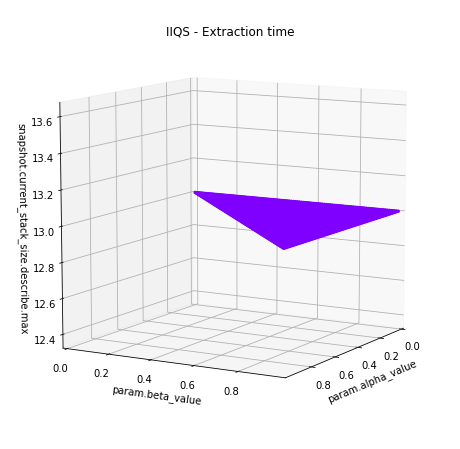

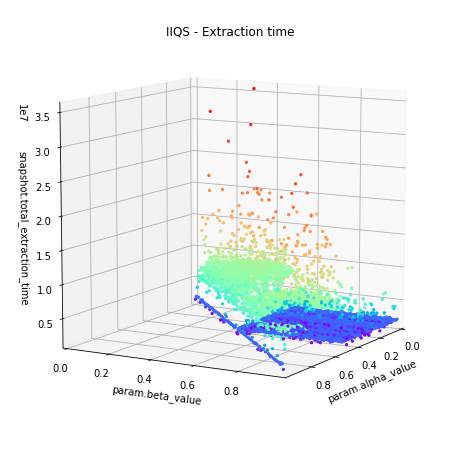

In [40]:
plotting.plot_stack_benchmark_3d(x='param.alpha_value',y='param.beta_value',z='snapshot.current_stack_size.describe.max',
                       data=result_df_alphabeta_proc, 
                        filters=[], 
                       title="Extraction time", 
                       file="04_alphabeta_singleclass_stack.png", s=5,
                      z2='snapshot.total_extraction_time')